# Project Cancer

### El **objetivo** de este proyecto es entrenar un modelo de ML de regresión logística para clasificar de forma binomial si un paciente tiene o no cancer.

## Observamos datos

Cargamos librerías

In [1]:
import pandas as pd
import numpy as np

Primeros vistazos del dataset

In [2]:
cancer = pd.read_csv("../data/data.csv")

In [3]:
cancer.head()

,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,...,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst,Unnamed: 32
0,842302,M,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,...,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890,NaN
1,842517,M,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,...,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902,NaN
2,84300903,M,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,...,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758,NaN
3,84348301,M,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,...,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300,NaN
4,84358402,M,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,...,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678,NaN


In [4]:
cancer.info(memory_usage="deep")

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 569 entries, 0 to 568
Data columns (total 33 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   id                       569 non-null    int64  
 1   diagnosis                569 non-null    object 
 2   radius_mean              569 non-null    float64
 3   texture_mean             569 non-null    float64
 4   perimeter_mean           569 non-null    float64
 5   area_mean                569 non-null    float64
 6   smoothness_mean          569 non-null    float64
 7   compactness_mean         569 non-null    float64
 8   concavity_mean           569 non-null    float64
 9   concave points_mean      569 non-null    float64
 10  symmetry_mean            569 non-null    float64
 11  fractal_dimension_mean   569 non-null    float64
 12  radius_se                569 non-null    float64
 13  texture_se               569 non-null    float64
 14  perimeter_se             5

## Manejo de valores nulos y columnas innecesarias

In [9]:
cancer.isnull().sum()

diagnosis                  0
radius_mean                0
texture_mean               0
perimeter_mean             0
area_mean                  0
smoothness_mean            0
compactness_mean           0
concavity_mean             0
concave points_mean        0
symmetry_mean              0
fractal_dimension_mean     0
radius_se                  0
texture_se                 0
perimeter_se               0
area_se                    0
smoothness_se              0
compactness_se             0
concavity_se               0
concave points_se          0
symmetry_se                0
fractal_dimension_se       0
radius_worst               0
texture_worst              0
perimeter_worst            0
area_worst                 0
smoothness_worst           0
compactness_worst          0
concavity_worst            0
concave points_worst       0
symmetry_worst             0
fractal_dimension_worst    0
dtype: int64

In [6]:
#borramos columna vacía, posinlemente de un índice mal guardado
cancer.drop(columns="Unnamed: 32", inplace=True)

In [8]:
#borramos la columna de id ya que no aportará valor para el análisis
cancer.drop(columns="id", inplace=True)

Terminamos con los valores nulos y columnas innecesarias previas a análisis.

## Convertir la columna objetivo en tipo numerico

The diagnosis of breast tissues (M = malignant, B = benign), así que los cambiaremos por M=0 y B=1

In [12]:
cancer.diagnosis.value_counts()

1    357
0    212
Name: diagnosis, dtype: int64

In [11]:
cancer["diagnosis"].replace(to_replace="M", value=0, inplace=True)
cancer["diagnosis"].replace(to_replace="B", value=1, inplace=True)

Ya todas las variables son numéricas, así que se puede comenzar con el análisis de las variables para identificar relaciones.

Podemos observar las correlaciones entre las variables.

## Escalabilidad de los datos

In [22]:
from sklearn.preprocessing import MinMaxScaler

In [23]:
#inicializamos el scalar
scaler = MinMaxScaler()
#renombramos df escalado y transformamos el df
cancer_scaled = scaler.fit_transform(cancer)

In [25]:
#al estar en formato array lo pasamos a df
cancer_scaled = pd.DataFrame(cancer_scaled)

In [27]:
#como perdemos el nombre de las columnas se las volvemos a asignar porque son las mismas
cancer_scaled.columns = cancer.columns

In [28]:
cancer_scaled.head()

,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
0,0.0,0.521037,0.022658,0.545989,0.363733,0.593753,0.792037,0.703140,0.731113,0.686364,...,0.620776,0.141525,0.668310,0.450698,0.601136,0.619292,0.568610,0.912027,0.598462,0.418864
1,0.0,0.643144,0.272574,0.615783,0.501591,0.289880,0.181768,0.203608,0.348757,0.379798,...,0.606901,0.303571,0.539818,0.435214,0.347553,0.154563,0.192971,0.639175,0.233590,0.222878
2,0.0,0.601496,0.390260,0.595743,0.449417,0.514309,0.431017,0.462512,0.635686,0.509596,...,0.556386,0.360075,0.508442,0.374508,0.483590,0.385375,0.359744,0.835052,0.403706,0.213433
3,0.0,0.210090,0.360839,0.233501,0.102906,0.811321,0.811361,0.565604,0.522863,0.776263,...,0.248310,0.385928,0.241347,0.094008,0.915472,0.814012,0.548642,0.884880,1.000000,0.773711
4,0.0,0.629893,0.156578,0.630986,0.489290,0.430351,0.347893,0.463918,0.518390,0.378283,...,0.519744,0.123934,0.506948,0.341575,0.437364,0.172415,0.319489,0.558419,0.157500,0.142595


# EDA (Análisis Exploratorio de los datos)

### Análisis de correlación

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

<AxesSubplot:>

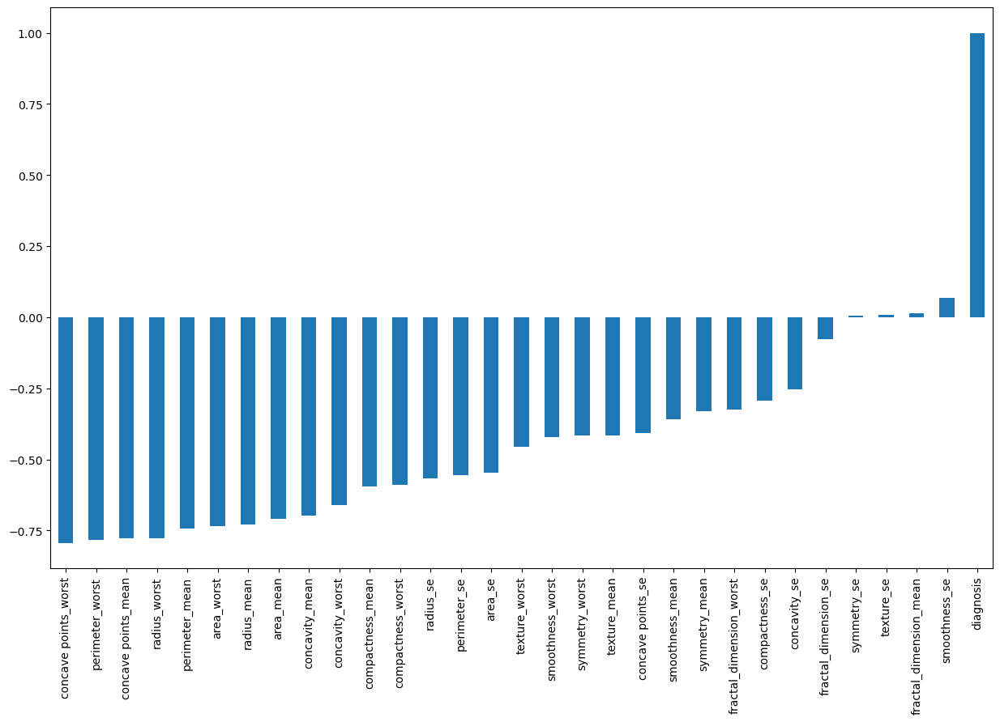

In [15]:
fig = plt.figure(figsize=(15,9))
cancer.corr()["diagnosis"].sort_values(ascending=True).plot(kind="bar")

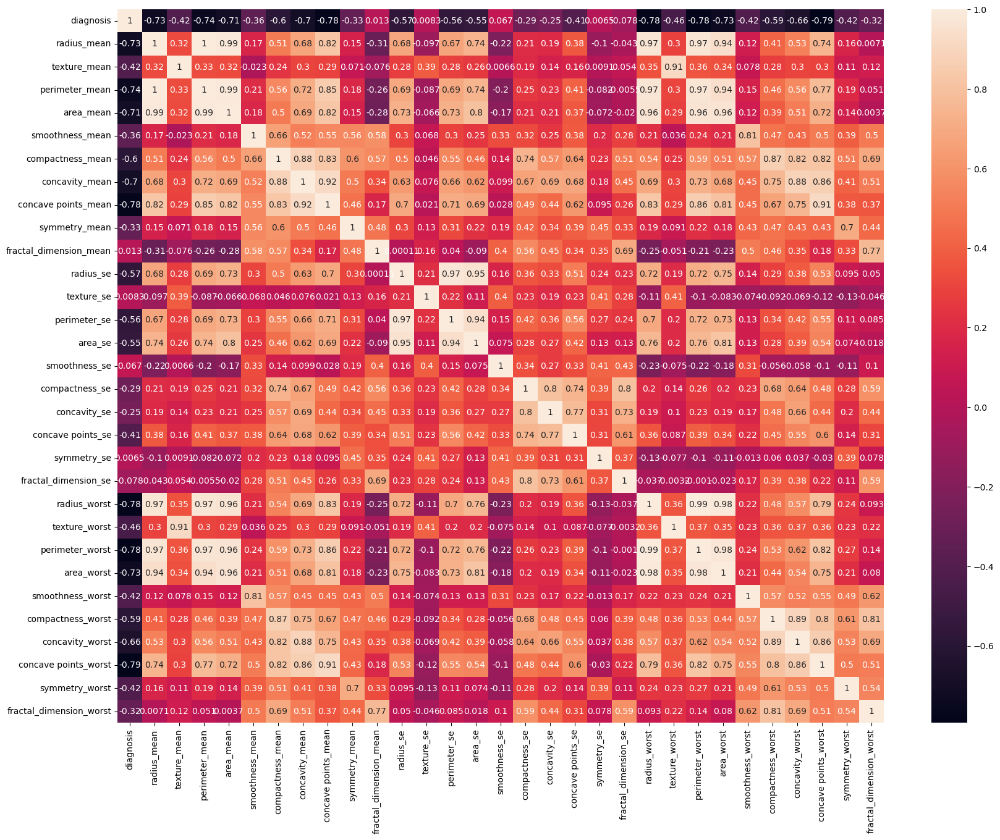

In [33]:
plt.figure(figsize=(20,15))
sns.heatmap(cancer.corr(), annot=True)
plt.show()

In [30]:
fig = plt.figure(figsize=(10,10))
sns.pairplot(data= cancer, hue='diagnosis')
plt.show()

<Figure size 1000x1000 with 0 Axes>

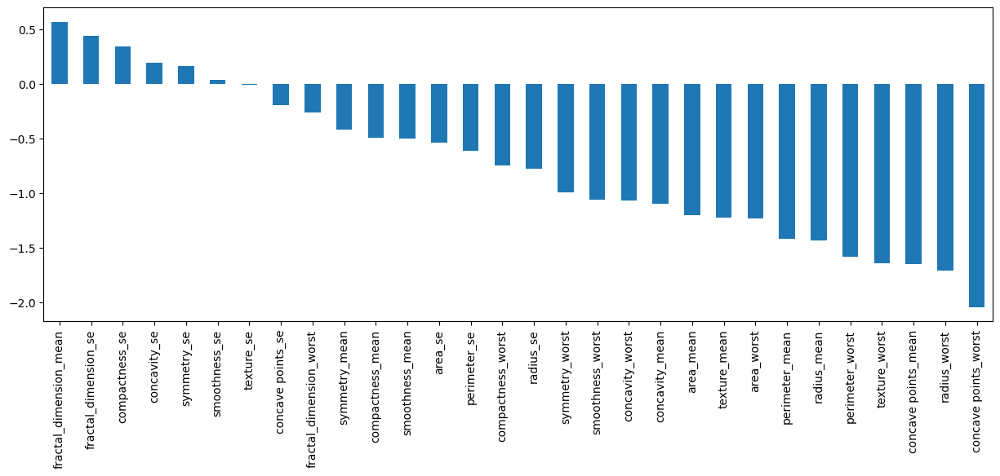

In [50]:
weights = pd.Series(ridge.coef_[0], index=X.columns.values).sort_values(ascending=False)
fig = plt.figure(figsize=(15,5))
weights.plot(kind='bar');

# Entrenamiento del Modelo

### Split de los datos train y test

In [34]:
X = cancer_scaled.drop(columns="diagnosis", axis=1)
y = cancer_scaled["diagnosis"]

In [35]:
from sklearn.model_selection import train_test_split
#hacemos split para dividir
X_train, X_test, y_train , y_test = train_test_split(X, y, random_state=42, shuffle=True, test_size= .2)

In [36]:
from sklearn.linear_model import LogisticRegression
#importamos el modelo y entrenamos
model = LogisticRegression()
result = model.fit(X_train, y_train)

In [37]:
from sklearn import metrics
#vemos el accuracy
prediction_test = model.predict(X_test)
print(metrics.accuracy_score(y_test,prediction_test ))

0.9824561403508771


# Evaluación del modelo

AxesSubplot(0.125,0.11;0.775x0.77)


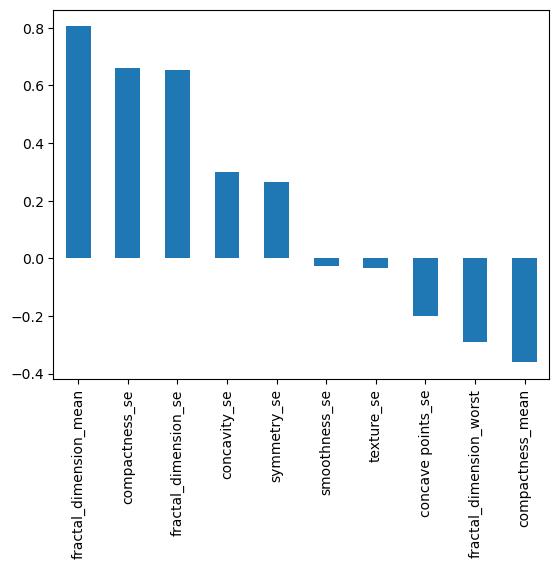

In [38]:
weights = pd.Series(model.coef_[0],
                    index=X.columns.values) 
print(weights.sort_values(ascending=False)[:10].plot(kind='bar'))

AxesSubplot(0.125,0.11;0.775x0.77)


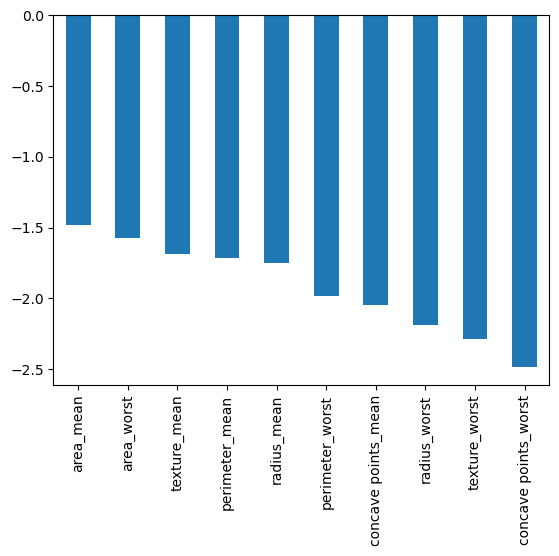

In [39]:
weights = pd.Series(model.coef_[0],
                    index=X.columns.values) 
print(weights.sort_values(ascending=False)[-10:].plot(kind='bar'))

<Figure size 1100x1100 with 0 Axes>

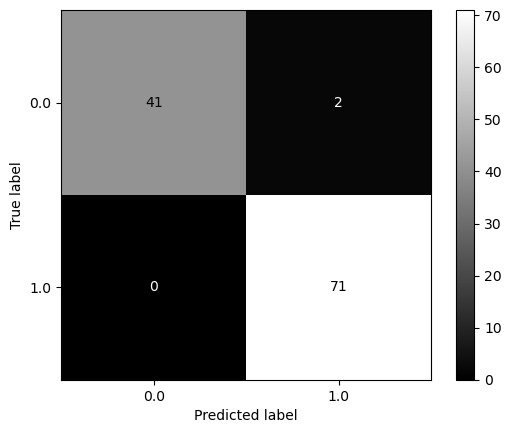

In [40]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
fig = plt.figure(figsize=(11,11))
cm = confusion_matrix(y_test, prediction_test, labels=model.classes_)
disp = ConfusionMatrixDisplay(confusion_matrix = cm, display_labels=model.classes_)
disp.plot(cmap='gray')
plt.show()

In [41]:
from sklearn.metrics import accuracy_score, log_loss, precision_score, recall_score, f1_score, r2_score, mean_absolute_error, mean_squared_error, confusion_matrix
# Calcular y imprimir las métricas de evaluación
accuracy = accuracy_score(y_test, prediction_test)
precision = precision_score(y_test, prediction_test)
recall = recall_score(y_test, prediction_test)
f1 = f1_score(y_test, prediction_test)
r2 = r2_score(y_test, prediction_test)
mae = mean_absolute_error(y_test, prediction_test)
mse = mean_squared_error(y_test, prediction_test)
rmse = np.sqrt(mse)

print("Accuracy: ", accuracy)
print("Precision: ", precision)
print("Recall: ", recall)
print("F1-score: ", f1)
print("R2-score: ", r2)
print("MAE: ", mae)
print("MSE: ", mse)
print("RMSE: ", rmse)

Accuracy:  0.9824561403508771
Precision:  0.9726027397260274
Recall:  1.0
F1-score:  0.9861111111111112
R2-score:  0.9253193580085162
MAE:  0.017543859649122806
MSE:  0.017543859649122806
RMSE:  0.13245323570650439


# Conclusiones:

### El modelo ha resultado tener una precisión muy alta, por lo que podría estar sobreentrenado, pero funciona bastante bien y tiene unas buenas métricas.

Para concluir haremos una comparación breve con otros modelos a ver sus métricas para saber cuál es el mejor para clasificar si tiene o no cáncer.

Model: Logistic Regression
Accuracy: 0.9824561403508771
Precision: 0.9726027397260274
Recall: 1.0
F1-score: 0.9861111111111112

Model: Random Forest
Accuracy: 0.9649122807017544
Precision: 0.958904109589041
Recall: 0.9859154929577465
F1-score: 0.9722222222222222

Model: SVM
Accuracy: 0.9736842105263158
Precision: 0.9722222222222222
Recall: 0.9859154929577465
F1-score: 0.979020979020979

Best Model: Logistic Regression


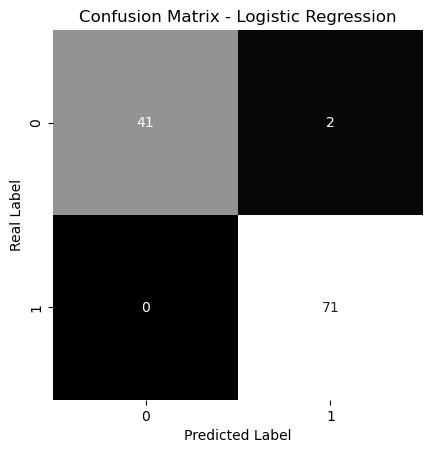

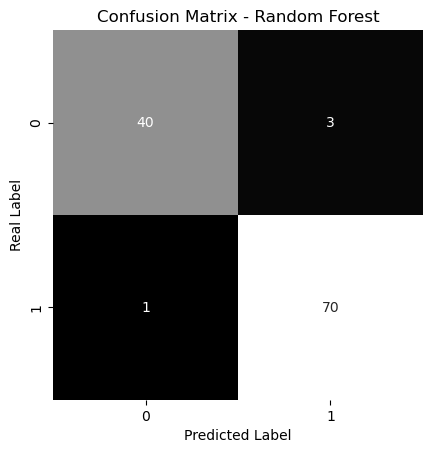

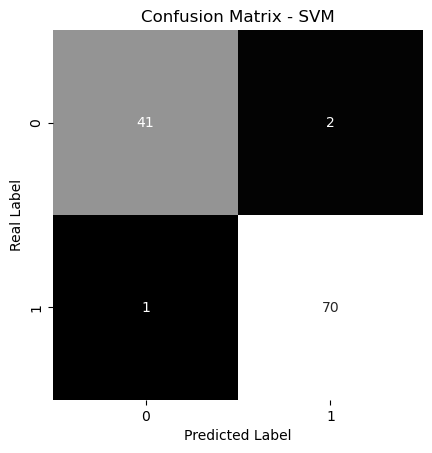

In [42]:
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier

# Definir los modelos
models = {
    'Logistic Regression': LogisticRegression(),
    'Random Forest': RandomForestClassifier(),
    'SVM': SVC()
}

# Entrenar y evaluar los modelos
results = {}
for model_name, model in models.items():
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    accuracy = accuracy_score(y_test, y_pred)
    precision = precision_score(y_test, y_pred)
    recall = recall_score(y_test, y_pred)
    f1 = f1_score(y_test, y_pred)
    results[model_name] = {
        'Accuracy': accuracy,
        'Precision': precision,
        'Recall': recall,
        'F1-score': f1
    }

    # Calcular y mostrar la matriz de confusión
    cm = confusion_matrix(y_test, y_pred)
    plt.figure()
    sns.heatmap(
        cm,
        annot=True,
        cmap='gray',
        cbar=False,
        square=True,
        fmt="d"
    )
    plt.ylabel('Real Label')
    plt.xlabel('Predicted Label')
    plt.title(f"Confusion Matrix - {model_name}")

# Obtener el modelo con la mejor precisión
best_model = max(results, key=lambda x: results[x]['Precision'])

# Imprimir los resultados y el mejor modelo
for model_name, metrics in results.items():
    print(f"Model: {model_name}")
    print(f"Accuracy: {metrics['Accuracy']}")
    print(f"Precision: {metrics['Precision']}")
    print(f"Recall: {metrics['Recall']}")
    print(f"F1-score: {metrics['F1-score']}")
    print()

print(f"Best Model: {best_model}")

# Mostrar todas las gráficas
plt.show()

### Comprobamos mediante regularizaciones la precisión del modelo

# Elastic Net

In [43]:
val_c=np.arange(0,1,0.01)
acc=[]
for i in val_c:
    acc.append(LogisticRegression(max_iter=10000, penalty='elasticnet',solver='saga',l1_ratio=i).fit(X_train, y_train).score(X_test,y_test))

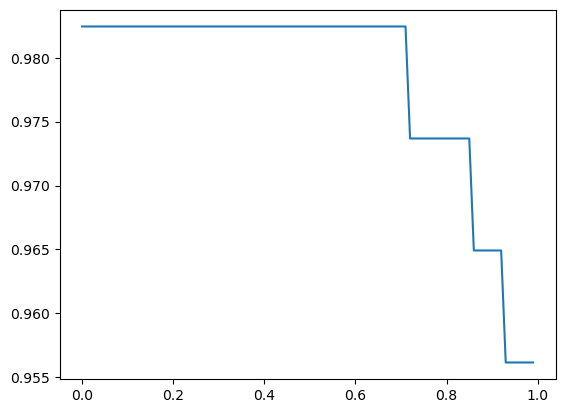

In [44]:
plt.plot(val_c,acc);

## L2 Ridge

In [45]:
ridge=LogisticRegression(max_iter=10000, penalty='l2',solver='saga',C=0.5)
ridge.fit(X_train, y_train)
ridge.score(X_test,y_test)

0.9649122807017544

# Lasso

In [46]:
lasso=LogisticRegression(max_iter=10000, penalty='l1',solver='saga',C=0.5)
lasso.fit(X_train, y_train)
lasso.score(X_test,y_test)

0.956140350877193

### **Conclusión**: Se ha entrenado un modelo de ML de regresión logística binomial para poder clasificar si tiene cancer: Maligno(M) = 0 o Benigno(B) = 1, con un:
    Accuracy: 0.9824561403508771
    Precision: 0.9726027397260274
    Recall: 1.0
    F1-score: 0.9861111111111112